# Práctica 2 - CNN con Keras para clasificar imágenes
## Introducción

En la práctica tenenmos la elección de implementar un modelo neuronal profundo a nuestra elección, ya sea un Deep Autoencoder o una Convolutional Neural Network, para un dataset a elegir de la página web [Kaggle](https://www.kaggle.com). Nuestro objetivo a lo largo de este notebook será el de desarrollar el modelo elegido, una CNN en nuestro caso (algo que explicaremos más adelante), utilizando las técnicas vistas en clase y cualquier otra necesaria para la correcta implementación del modelo con la librería `Keras` de `Tensorflow`

## Dataset Elegido

![MLP Neural Network](https://storage.googleapis.com/kaggle-datasets-images/177084/399170/7d90f4493015ceb9f5f56e7b3de0eb13/dataset-cover.jpg?t=2019-06-22-12-23-20)

En nuestro caso hemos elegido un dataset de imágenes con todos los símbolos del [Lenguaje de Signos Americano](https://www.kaggle.com/datasets/ayuraj/asl-dataset?datasetId=177084&sortBy=commentCount) (habríamos utilizado uno con Lenguaje de Signos Español, pero [el que hemos encontrado](https://www.kaggle.com/datasets/kirlelea/spanish-sign-language-alphabet-static) era muy pesado).

Debido a la naturaleza del modelo que hemos elegido, hemos decidido utilizar una CNN debido, principalmente, al número de clases y, en menor medida, a la naturaleza de las imágenes.

El dataset viene repartido únicamente por clases, por lo que dependerá de nosotros separarlas en datos de entrenamiento, validación y prueba durante el preprocesamiento.

## Estructura de la red

La estructura de la red es semejante a la que se muestra en la imágen a continuación (obtenida de GeeksforGeeks):

![MLP Neural Network](https://media.geeksforgeeks.org/wp-content/uploads/20200219152207/new41.jpg "Convolutional Neural Network")


### Hiperparámetros

#### Capa de Convolución

+ <b>Número de Capas</b> &rarr; 3 (a partir de la 3ª capa, añadir más no cambia mucho el resultado)
+ <b>Número de filtros</b> &rarr; 32 - 64 - 128
+ <b>Dimensión de cada filtro</b> &rarr; 3x3
+ <b>Tamaño del Stride</b> &rarr; 1
+ <b>Tipo de Padding</b> &rarr; Zero Padding (de tamaño 1)
+ <b>Función de Activación</b> &rarr; ReLu

#### Capa de Pooling

+ <b>Tipo de Pooling</b> &rarr; Max Pooling (aunque Average Pooling también está implementado)
+ <b>Tamaño del Pooling</b> &rarr; 2x2
+ <b>Tamaño del stride</b> &rarr; 1

#### Capa Fully Connected

+ <b>Número de Capas</b> &rarr; 1 (al no dejar de ser un MLP, nos podemos basar en el Teorema de Aproximación Universal)
+ <b>Número de neuronas</b> &rarr; 128 (Numero de filtros de la última capa de convolución * número de canales de la imágen)
+ <b>Función de Activación</b> &rarr; ReLu - Softmax (para la salida); utilizamos Softmax y no Sigmoide porque tenemos una salida no binaria

### Configuración del Modelo

+ <b>Modelo</b> &rarr; Sequential
+ <b>Capa Convolucional</b> &rarr; Conv2D
+ <b>Capa de Pooling</b> &rarr; MaxPool2D
+ <b>Capa Fully Connected</b> &rarr; Dense
+ <b>Optimizador</b> &rarr; Adam
+ <b>Función de Error</b> &rarr; Categorical Crossentropy
+ <b>Learning Rate</b> &rarr; 0.005 - 0.001 - 0.0005 - 0.0001 - 0.00005 - 0.00001

## Implementación

### Importar librerías de código

En nuestro caso hemos reducido al mínimo el número de librerías de código a utilizar para esta práctica; en nuestro caso utilizamos las siguientes:

- <ins>Tensorflow</ins> &rarr; TensorFlow es una biblioteca de software gratuita y de código abierto para el aprendizaje automático y la inteligencia artificial. Utilizamos Tensorflow para:
  - Modelos de Keras:
    - Creación 🧠
    - Entrenamiento 🏋
    - Validación ✅
  - Visualización de modelos 📊
- <ins>IPython</ins> &rarr; IPython es un shell de comandos para computación interactiva en múltiples lenguajes de programación, desarrollado originalmente para el lenguaje de programación Python. Utilizamos IPython para:
  - Creación y visualización de imágenes y gráficos 🖼
- <ins>Numpy</ins> &rarr; Es una librería numérica que trae el poder computacional de lenguajes como C y Fortran a Python. Utilizamos Numpy para:
  - Utilizar arrays 🔲
  - Transformación de arrays y listas 📶
- <ins>Importlib-Metadata</ins> &rarr; Librería para encontrar versiones de librerías 🔖
- <ins>Glob</ins> &rarr; Librería para lectura de directorios 🗂️
- <ins>splitfolders</ins> &rarr; Librería para separación de directorios 🗃️
- <ins>Pandas</ins> &rarr; Es una librería de manipulación y análisis de datos de código abierto rápida, potente, flexible y fácil de usar, construida sobre el lenguaje de programación Python. Usamos Pandas para:
  - Dataframes 📅
- <ins>Scikit-learn</ins> &rarr; Es una librería de aprendizaje automático de software gratuito para el lenguaje de programación Python. Usamos Scikit-learn para:
  - Evaluación de modelos 🔍
- <ins>Matplotlib</ins> &rarr; Es una librería para crear visualizaciones estáticas, animadas e interactivas en Python. Usamos Matplotlib para:
  - Mostrar gráficos 📊
  - Tipo de renderizado `inline`
- <ins>Librerías del Sistema</ins> &rarr; Conjunto de librerías por defecto de Python. Usamos:
  - `os` para directorios 📂
  - `math` para funciones de aproximación numérica 🧮
  - `time` para funcionalidades miscelanea de ipywidgets ⌚
- <ins>Ipywidgets</ins> &rarr; Conjunto de librerías por defecto de Python. Usamos:
  - Checkboxes ☑️
  - Barras de carga ⏳
  - Dropdown 👆

In [ ]:
print('Versiones de las librerías con las que vamos a trabajar:')
# Librerías para redes neuronales
import tensorflow as tf
from tensorflow import keras as ks
from tensorflow.keras import layers as ly
from tensorflow.keras.preprocessing.image import ImageDataGenerator
print('\tTensorflow y Keras\t>>> \tv', tf.__version__)
# Librería gráfica
import IPython as ip
from IPython.display import SVG, display, display_html, HTML
print('\tIPython\t\t\t>>> \tv', ip.__version__)
# Librerías del sistema
import os
import math
import time
# Librerías de jupyter notebooks
from ipywidgets import IntProgress, Checkbox, Dropdown
# Comprobar versiones de las librerías
import importlib.metadata
print('\tIportlib-Metadata\t>>> \tv', importlib.metadata.version('importlib-metadata'))
# Librería de acceso a directorios
import glob
print('\tGlob\t\t\t>>> \tv', importlib.metadata.version('glob2'))
# Librería para dividir directorios
import splitfolders
print('\tSplit-folders\t\t>>> \tv', splitfolders.__version__)
# Librería para tratamiento de imágenes utilizada para interpolation en ImageDataGenerator
import PIL
print('\tPillow\t\t\t>>> \tv', PIL.__version__)
# Librería numnérica
import numpy as np
print('\tNumpy\t\t\t>>> \tv', np.__version__)
# Librerías para estructuras de datos
import pandas as pd
print('\tPandas\t\t\t>>> \tv', pd.__version__)
import sklearn as sk
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
print('\tSklearn\t\t\t>>> \tv', sk.__version__)
# Librería gráfica
import matplotlib as mplt
import matplotlib.pyplot as plt
%matplotlib inline
print('\tMatplotlib\t\t>>> \tv', mplt.__version__)
# Ignorar Warnings
import warnings
warnings.filterwarnings('ignore')

Versiones de las librerías con las que vamos a trabajar:
	Tensorflow y Keras	>>> 	v 2.10.0
	IPython			>>> 	v 8.12.0
	Iportlib-Metadata	>>> 	v 6.1.0
	Glob			>>> 	v 0.7
	Split-folders		>>> 	v 0.5.1
	Pillow			>>> 	v 9.4.0
	Numpy			>>> 	v 1.23.5
	Pandas			>>> 	v 1.5.3
	Sklearn			>>> 	v 1.2.2
	Matplotlib		>>> 	v 3.7.1


### Configurar Modelo

En la celda a continuación damos la opción de cambiar la configuración del modelo creado; sin embargo, la configuración por defecto es la recomendada y sobre la que se trabajarán datos y conclusiones en celdas más adelante.

Para cambiar la configuración simplemente seleccionar la configuración en los widgets a continuación antes de ejecutar una celda del notebook a la que puedan afectar.

In [ ]:
# Configuración óptima, cambiar booleanos para llegar a otra
standard_ratio = Checkbox(value=True, description='Aspect Ratio Estándar', disabled=False)
average_pooling = Checkbox(value=False, description='Utilizar Average Pooling', disabled=False)
data_augmentation = Checkbox(value=True, description='Realizar Data Aumentation', disabled=False)

customizar_lr = Checkbox(value=False, description='Learning Rate específico', disabled=False)
lr_custom = Dropdown(
    options=[('0.005', 0), ('0.001', 1), ('0.0005', 2), ('0.0001', 3), ('0.00005', 4), ('0.00001', 5)],
    value=1,
    description='Learn. Rate:',
)
print("Seleccionar configuración de la red\n(Configuración óptima por defecto)")
display(standard_ratio,average_pooling,data_augmentation,customizar_lr, lr_custom)

Seleccionar configuración de la red
(Configuración óptima por defecto)


Checkbox(value=True, description='Aspect Ratio Estándar')

Checkbox(value=False, description='Utilizar Average Pooling')

Checkbox(value=True, description='Realizar Data Aumentation')

Checkbox(value=False, description='Learning Rate específico')

Dropdown(description='Learn. Rate:', index=2, options=(('0.005', 0), ('0.001', 1), ('0.0005', 2), ('0.0001', 3…

### Exploración del Dataset

A continuación exploramos los datos de las clases del dataset. Nos centraremos en el número de clases, sus tamaños y la relación entre ellos.

IntProgress(value=0, description='Explorando:', max=36)

El número de clases es de  36


,Emoción,Cantidad
0,0,70
1,1,70
2,2,70
3,3,70
4,4,70
5,5,70
6,6,70
7,7,70
8,8,70
9,9,70


IntProgress(value=0, description='Analizando:', max=36)

La diferencia (media) media entre el número de elementos de las clases es de  0.2777777777777777
La diferencia (media) máxima entre el número de elementos de las clases es de 5.0 en la clase t
La diferencia (media) mínima entre el número de elementos de las clases es de 0.14285714285714285 en la clase 0
El número máximo de elementos de las clases es de 70 en la clase 0
El número mínimo de elementos de las clases es de 65 en la clase t


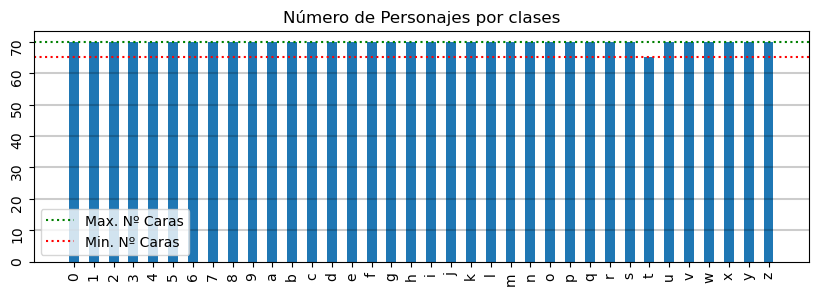

In [ ]:
labels = []
values = []

pBar1 = IntProgress(value=0, min=0, max=len(os.listdir("./asl_dataset")), description='Explorando:')
display(pBar1)

for path in os.listdir("./asl_dataset"):
    labels.append(str(path))
    values.append(len(os.listdir(os.path.join("./asl_dataset", path))))
    pBar1.value += 1
    time.sleep(.1)

print('El número de clases es de ', len(labels))
dic = {'Emoción':labels,'Cantidad':values}
df = pd.DataFrame(dic)

display_html(df)

pBar2 = IntProgress(value=0, min=0, max=len(values), description='Analizando:')
display(pBar2)

dif = []
for i in range(len(values)):
    sumt = 0
    for j in range(len(values)):
        if i != j:
            sumt += abs(values[i]-values[j])
    dif.append(sumt/(len(values)-1))
    pBar2.value += 1
    time.sleep(.1)

dif_mean = np.sum(dif)/len(dif)
print('La diferencia (media) media entre el número de elementos de las clases es de ', dif_mean)
print('La diferencia (media) máxima entre el número de elementos de las clases es de ' + str(max(dif)) + ' en la clase ' + str(labels[dif.index(max(dif))]))
print('La diferencia (media) mínima entre el número de elementos de las clases es de ' + str(min(dif)) + ' en la clase ' + str(labels[dif.index(min(dif))]))
print('El número máximo de elementos de las clases es de ' + str(max(values)) + ' en la clase ' + str(labels[values.index(max(values))]))
print('El número mínimo de elementos de las clases es de ' + str(min(values)) + ' en la clase ' + str(labels[values.index(min(values))]))
plt.figure(figsize=(10, 3))
plt.axhline(10, color='black', ls='-', alpha=0.2)
plt.axhline(20, color='black', ls='-', alpha=0.2)
plt.axhline(30, color='black', ls='-', alpha=0.2)
plt.axhline(40, color='black', ls='-', alpha=0.2)
plt.axhline(50, color='black', ls='-', alpha=0.2)
plt.axhline(60, color='black', ls='-', alpha=0.2)
plt.axhline(max(values), color='green', ls='dotted', label="Max. Nº Caras")
plt.axhline(min(values), color='red', ls='dotted', label="Min. Nº Caras")
plt.bar(labels, values, align='center', width=0.5)
plt.title("Número de Personajes por clases")
plt.xticks(rotation=90)
plt.yticks(rotation=90)
plt.legend()
plt.show()

Como podemos observar en los resultados de la celda anterior, los datos estan distribuidos de manera muy uniforme; por lo que, de no ser por el hecho de que las clases contienen una cantidad muy reducida de información, no se necesitaría Data Augmentation.

Sin embargo, como hemos dicho, la poca cantidad de datos por clase hace que aplicar Data Augmentation sea una opción viable (aunque no tan a gran escala como en un dataset desbalanceado).

### Preparación de Directorios

Como hemos dicho en el apartado de *"Dataset Elegido"*, necesitaremos separar las imágenes en entrenamiento, validación y prueba; para ello, utilizamos la librería `splitfolders` para repartirlos en nuevos directorios en una proporción de 80%, 15% y 5% (respectivamente).

Dividimos los datos de esta manera [basandonos](https://towardsdatascience.com/how-to-split-data-into-three-sets-train-validation-and-test-and-why-e50d22d3e54c) en:

+ En función a los hiperparámetros de la red, donde cuanto más haya, mayor deberá ser el tamaño de los datos de validación
+ En función al tamaño del dataset y del modelo (siendo que algunos modelos necesitan un conjunto de datos de entrenamiento más extenso)

En nuestro caso, debido a la proporción de datos por clase y a que vamos a hacer Data Augmentation, podemos permitirnos tener un reparto de datos como el realizado, con un conjunto de validación mayor y un conjunto de entrenamiento externo.

In [ ]:
# Si se quiere comprobar la división, dejar una carpeta vacía con el nombre datos en el directório de la práctica
# Comprobamos si las clases están divididas
if len(os.listdir("./datos")) == 0:
    print("Dividiendo archivos")
    # Dividimos las clases
    splitfolders.ratio("./asl_dataset",
                   output="./datos",
                   seed=42,
                   ratio=(.8, .15, .05), # Dividir directorio en train, test y validation
                   group_prefix=None,
                   move=False
                   )
    print("Archivos divididos")
else:
    print("Los archivos ya están divididos")

Los archivos ya están divididos


#### Función para Obtener Resolución

En caso de no utilizar la resolución estándar, utilizaremos la siguiente función para obtener la resolución a utilizar.

In [ ]:
def get_best_res(path:str):
    alto = []
    ancho = []

    pBar = IntProgress(value=0, min=0, max=len(glob.glob(path)), description='Aspect Ratio:')
    display(pBar)

    # Guardo las características de las imágenes del directorio
    for img_path in glob.glob(path):
        img = Image.open(img_path)
        alto.append(img.size[1]) # Guardo alto
        ancho.append(img.size[0]) # Guardo ancho
        pBar.value += 1
        time.sleep(.1)

    if sum(ancho) < sum(alto): # Tomamos el tamaño mínimo para el mejor rendimiento
        return (round(sum(ancho)/len(ancho)),round(sum(ancho)/len(ancho))) # Para mantener imágenes cuadradas
    else:
        return (round(sum(alto)/len(alto)),round(sum(alto)/len(alto))) # Para mantener imágenes cuadradas


### Adquisición de Imágenes y Data Augmentation

A continuación, utilizamos la función `ImageDataGenerator` para preparar Data Augmentation y preparar la adquisición de imágenes del directorio correspondiente.

Para tomar estas imágenes (ya aumentadas) lo único que necesitaríamos ahora es llamar a la función `flow_from_directory` del generador creado previametne, que crea un `DirectoryIterator` del que se obtendrán las imágenes del directorio correspondiente, aplicandole las siguientes transformaciones (a las imágenes de entrenamiento), además de normalizar los datos y cambiar todas las imágenes a la resolución deseada (recortando la imágen pero manteniendo el [*aspect ratio*](https://stats.stackexchange.com/questions/240690/non-square-images-for-image-classification#:~:text=Most%20CNN%20training%20datasets%20have,4%20corners%20is%20a%20classic)):

+ Mover la imágen a un lado o al otro
+ Mover la imágen hacia arriba o hacia abajo
+ Voltear la imágen horizontalmente
+ Tomar las imágenes en grayscale. Dado que, al utilizar Max Pooling, se seleccionarán los pixeles más brillantes, asique hacemos que la mano destaque más sobre el fondo. Si utilizamos Mean Pooling, se suavizaría la imágen y no se destacarían las características más fuertes.

La resolución que hemos elegido para las imágenes (96x96) viene dada por Jumana Al-Shweiki en la [siguiente respuesta](https://www.researchgate.net/post/Which_Image_resolution_should_I_use_for_training_for_deep_neural_network/6051b7d5c09ed04d7d488659/citation/download) en ResearchGate.

Por otro lado, dejamos el batch_size por defecto (32) según lo visto en la [siguiente página](https://wandb.ai/ayush-thakur/dl-question-bank/reports/What-s-the-Optimal-Batch-Size-to-Train-a-Neural-Network---VmlldzoyMDkyNDU), donde se concluye que:

+ A mayor tamaño, peor generalización; tardando menos tiempo pero teniendo peores resultados
+ A menor tamaño; más lento pero mejores resultados
+ 32 es el batch_size ideal, debido a que:
    + No aumenta el tiempo de entrenamiento como batch_sizes menores
    + Obtiene los mejores resultados de error y precisión

In [ ]:
if not data_augmentation.value:
    datagen_train = ImageDataGenerator(rescale=1.0/255.0)# Normalizar lod datos de los canales
else:
    datagen_train = ImageDataGenerator(
        rescale=1.0/255.0, # Normalizar los datos de los canales
        # shear_range=0.1, # Descomentar esta línea en un dataset desbalanceado
        # zoom_range=0.1, # Descomentar esta línea en un dataset desbalanceado
        width_shift_range=0.1,
        height_shift_range=0.1,
        # rotation_range=45, # Descomentar esta línea en un dataset desbalanceado
        # horizontal_flip=True, # Descomentar esta línea en un dataset desbalanceado (en el que las imágenes giradas no se confundan entre ellas)
        )

datagen_test_val = ImageDataGenerator(rescale=1.0/255.0) # Normalizar lod datos de los canales

if not standard_ratio.value:
    target_res = get_best_res("datos/train/0/*.jpg") # Comprobamos las dimensiones para una clase
    print('Target Aspect Ratio: ' + str(target_res[0]) + ' x ' + str((target_res[1])) + '\n')
else:
    target_res = (96, 96)
    print('Target Aspect Ratio: ' + str(target_res[0]) + ' x ' + str((target_res[1])) + '\n')

# Datos de entrenamiento
train_img = datagen_train.flow_from_directory(
    "./datos/train",
    target_size=target_res,
    classes=None, # Las tomará del directorio
    class_mode='categorical',
    shuffle=True,
    color_mode="grayscale", # Las tomamos en un solo canal para mejorar la eficacia del max pooling
    seed=42,
    interpolation='lanczos',
    keep_aspect_ratio=True # Recortará la imágen pero mantendrá el aspect ratio
)

# Datos de validación
val_img = datagen_test_val.flow_from_directory(
    "./datos/val",
    target_size=target_res,
    classes=None, # Las tomará del directorio
    class_mode='categorical',
    color_mode="grayscale", # Las tomamos en un solo canal para mejorar la eficacia del max pooling
    keep_aspect_ratio=True # Recortará la imágen pero mantendrá el aspect ratio
)

# Datos de prueba
test_img = datagen_test_val.flow_from_directory(
    "./datos/test",
    target_size=target_res,
    classes=None, # Las tomará del directorio
    class_mode='categorical',
    color_mode="grayscale", # Las tomamos en un solo canal para mejorar la eficacia del max pooling
    keep_aspect_ratio=True # Recortará la imágen pero mantendrá el aspect ratio
)


Target Aspect Ratio: 96 x 96

Found 2012 images belonging to 36 classes.
Found 359 images belonging to 36 classes.
Found 144 images belonging to 36 classes.


### Mostramos Ejemplo

En la siguiente celda, mostramos un ejemplo de lo que puede encontrarse el modelo durante 1 epoch de entrenamiento.

IntProgress(value=0, description='Ejemplos:', max=63)

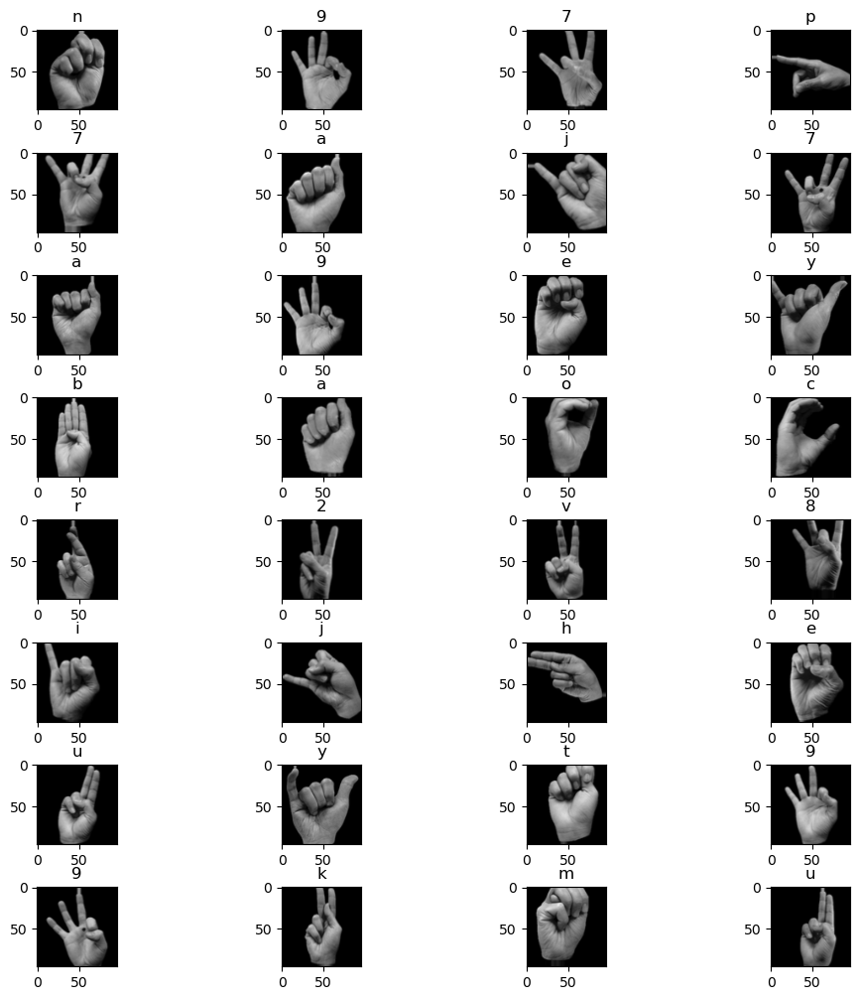

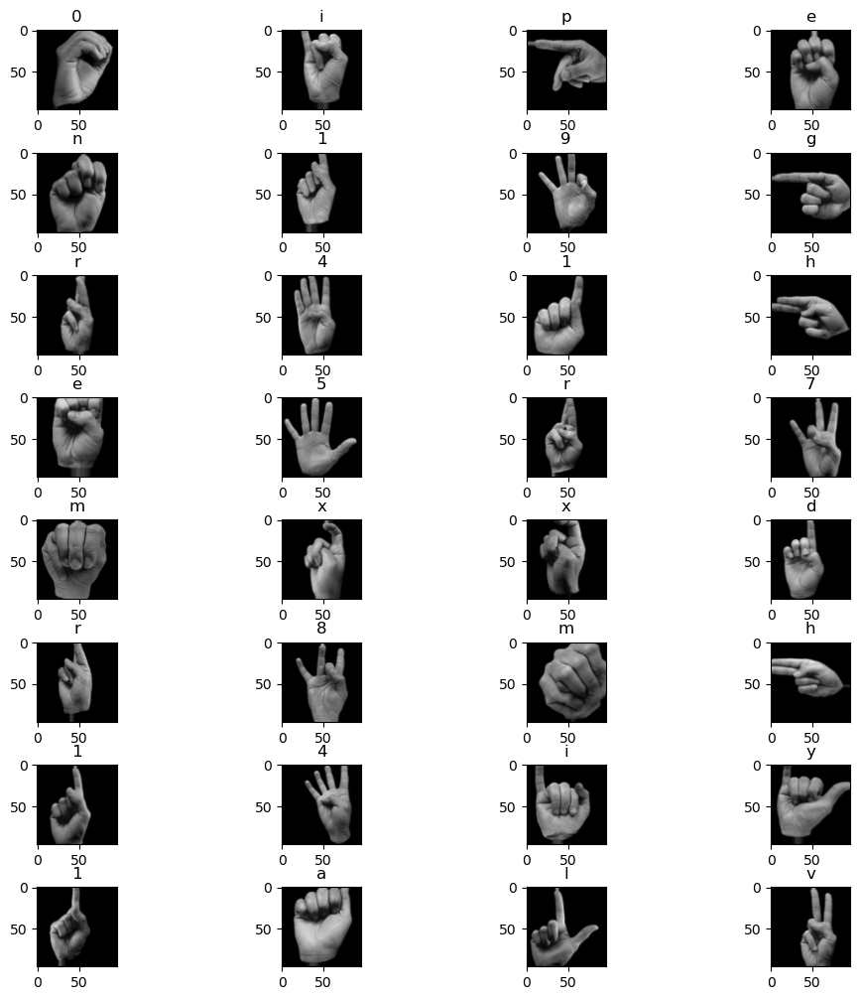

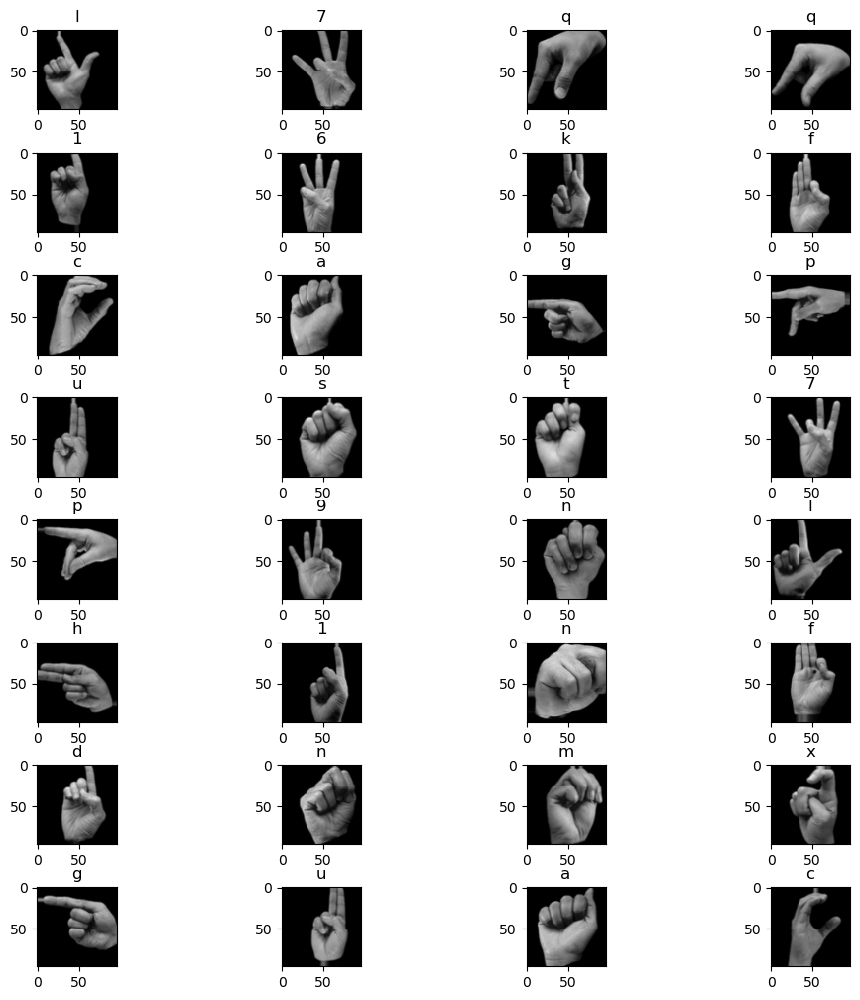

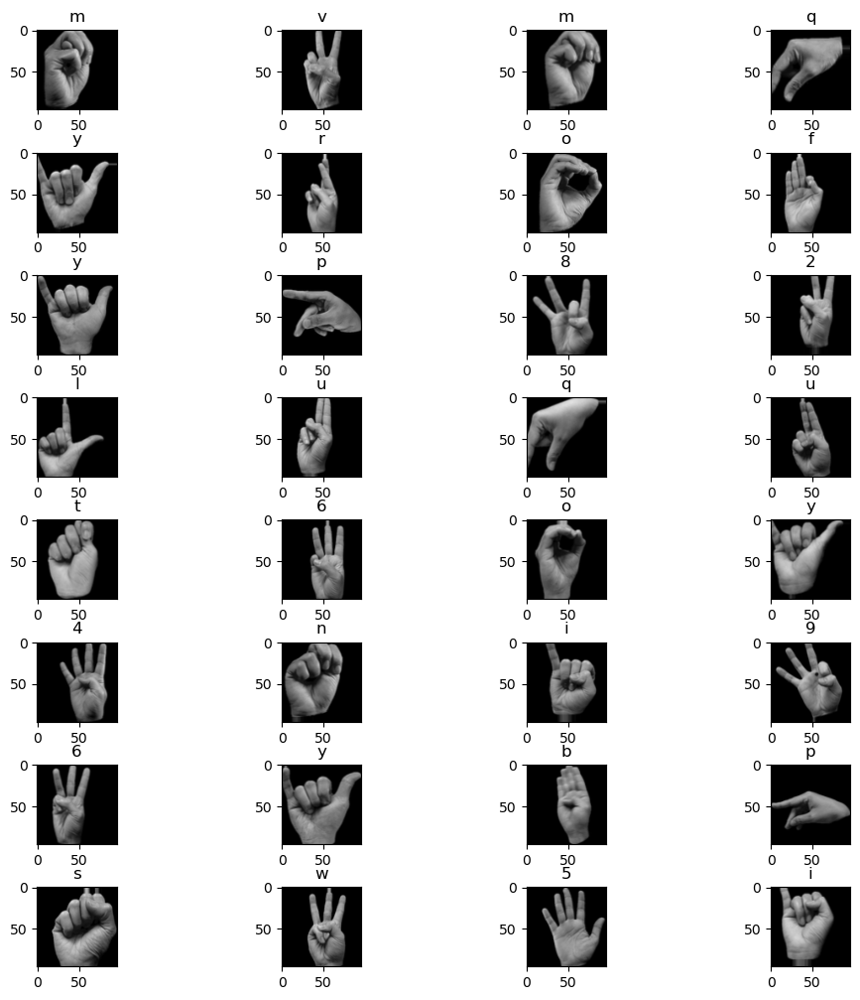

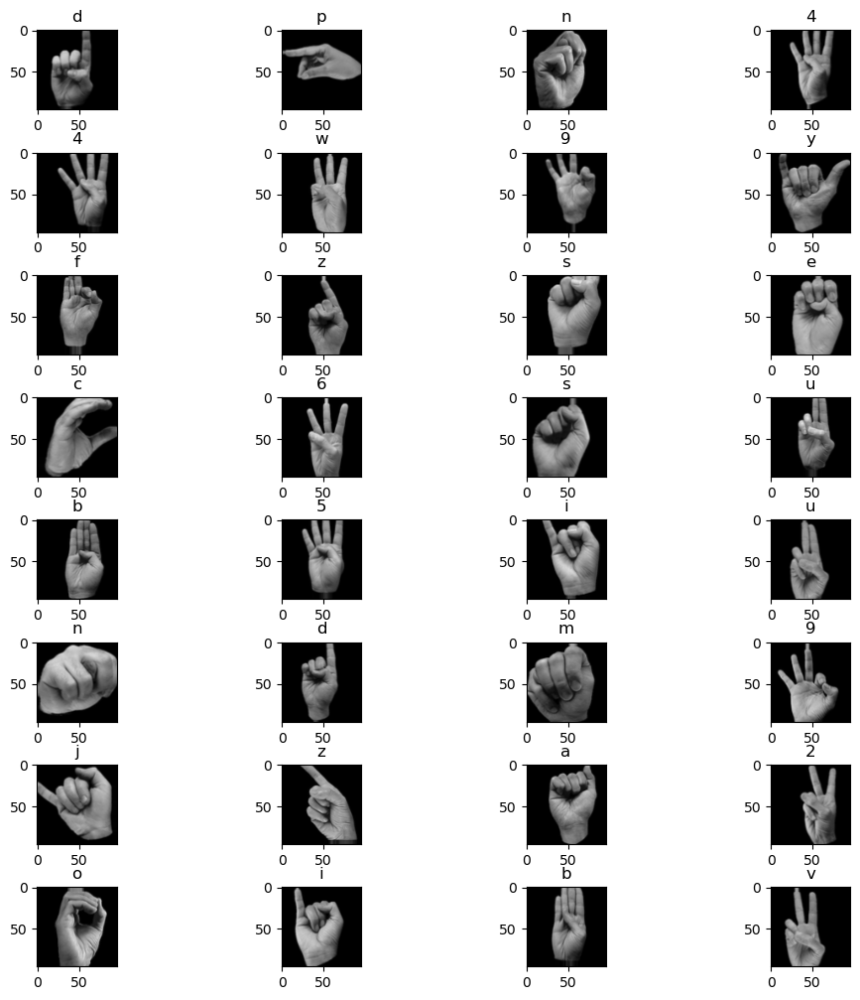

...

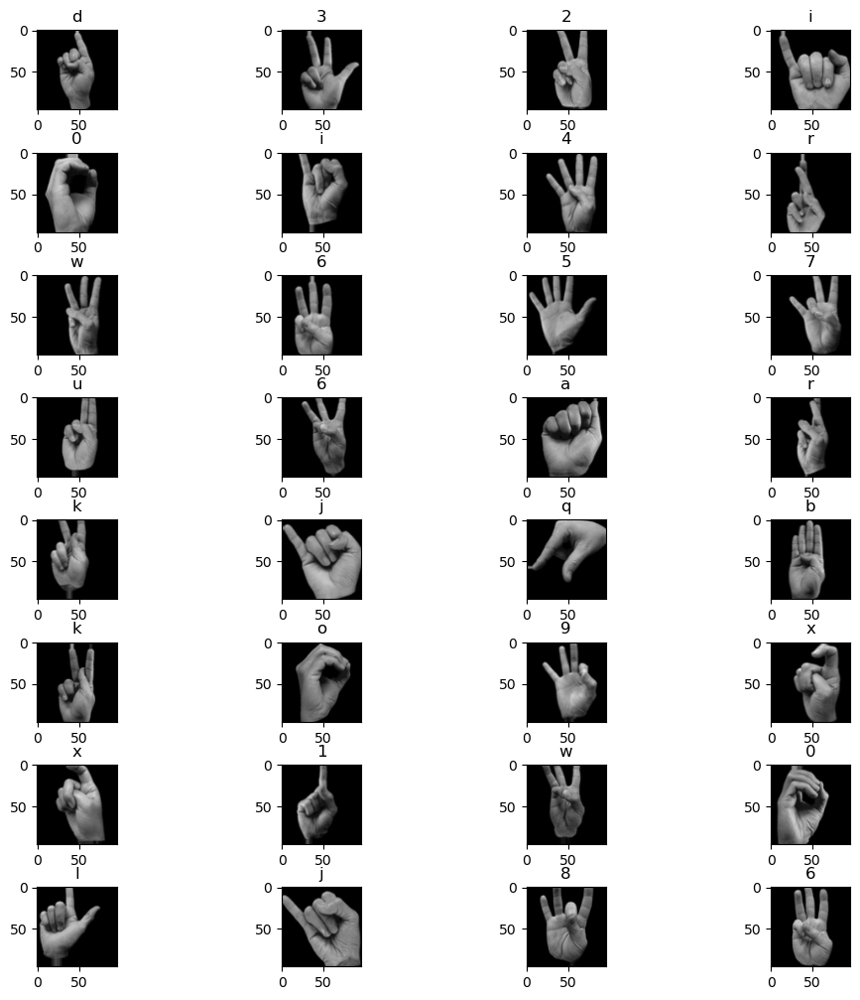

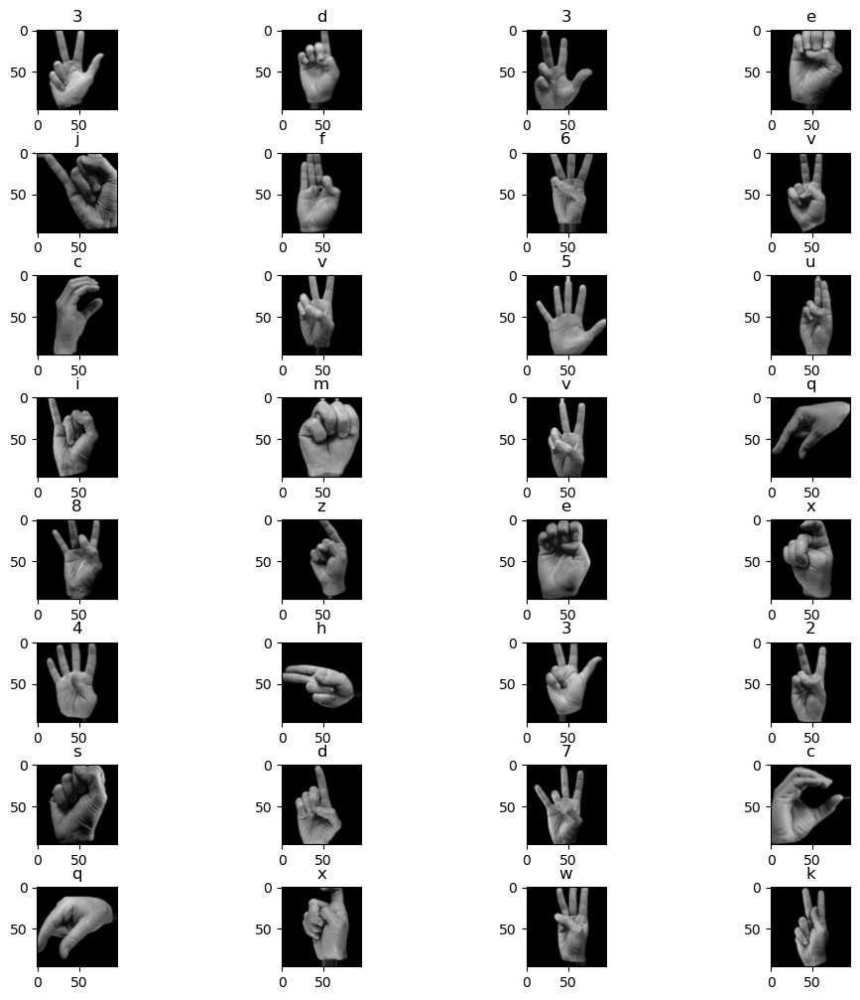

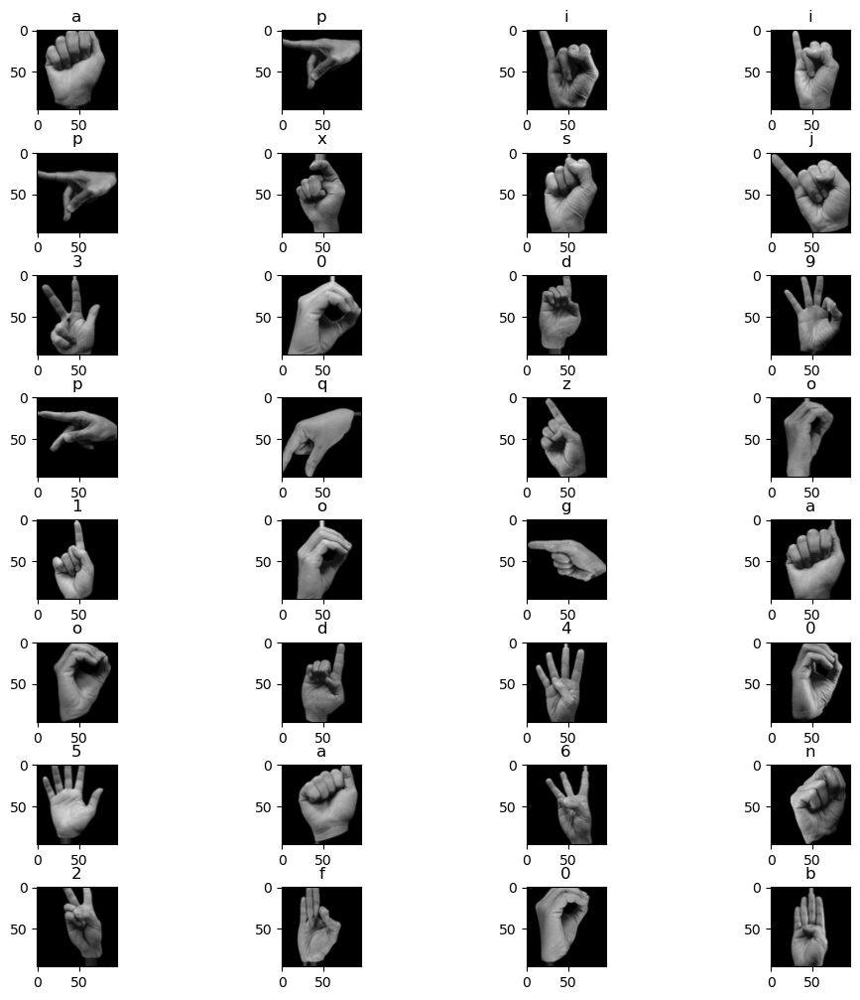

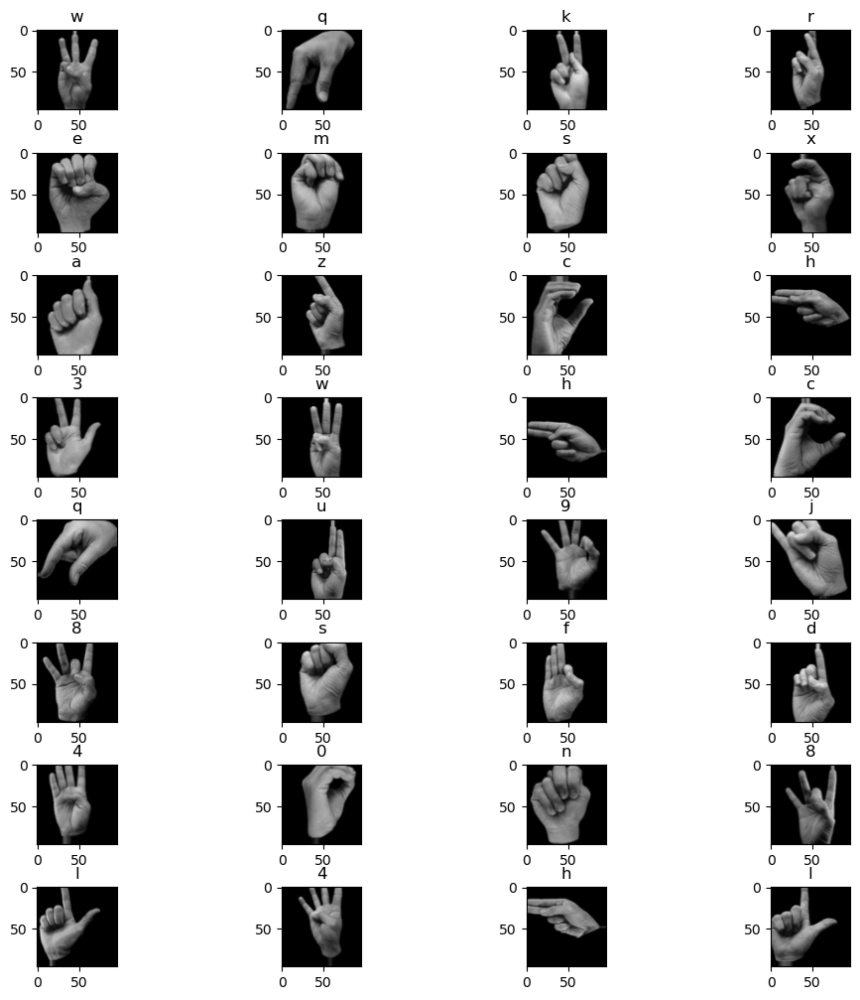

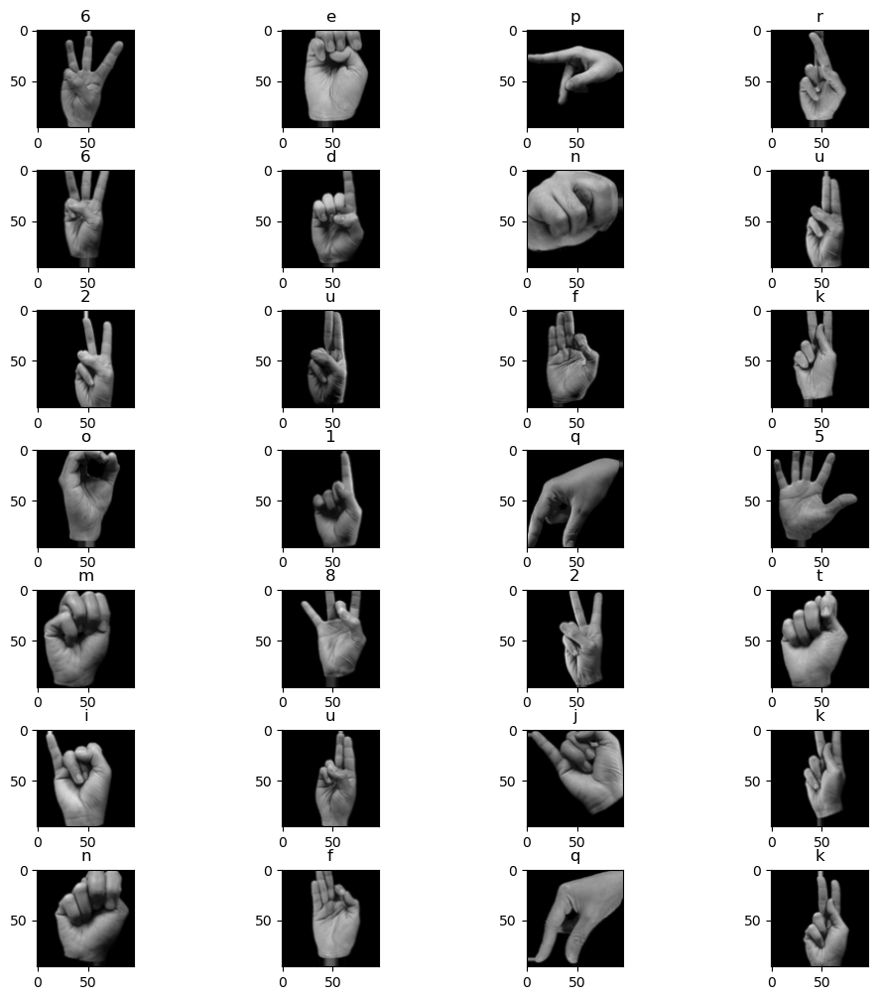

In [ ]:
pBar = IntProgress(value=0, min=0, max=train_img.__len__(), description='Ejemplos:')
display(pBar)

for _ in range(train_img.__len__()):
    imgs, label = train_img.next()
    fig, axs = plt.subplots(int(math.ceil(imgs.shape[0]/4)),4, figsize=(10, 10))
    fig.tight_layout(pad=1)
    for i in range(imgs.shape[0]):
        axs[int(math.floor(i/4)),i%4].imshow(imgs[i], cmap='gray', vmin=0, vmax=1)
        axs[int(math.floor(i/4)),i%4].set_title(labels[int(np.where(label[i] == 1)[0])])
    plt.show()
    pBar.value += 1
    time.sleep(.1)

### Arquitectura y Entrenamiento de Modelos

A continuación contamos con 3 funciones que se encargan de:

+ `createModel_MP()` &rarr; Genera un modelo con max pooling
+ `createModel_AP()` &rarr; Genera un modelo con mean pooling
+ `trainModel()` &rarr; Entrena un modelo

#### Modelo con Max/Mean Pooling

El modelo cuenta con 3 fases de convolución (cada una compuesta de una capa `Conv2D()` y una capa `MaxPool2D`), una capa fully connected (a la que tenemos que aplanar los datos de salida de la última fase de convolución con una capa `Flaten()`) y la salida de la red (con tantas neuronas como clases y con la función de activación Softmax); basandonos en [este post](https://stackoverflow.com/questions/24509921/how-do-you-decide-the-parameters-of-a-convolutional-neural-network-for-image-cla).

La entrada del modelo es de (ANCHO x ALTO X CANALES).

Tanto para el número de filtros por capa convolucional como para el número de neuronas de la capa fully connected no hay una regla absoluta. Nosotros nos basamos en:

+ Para el número de filtros &rarr; [link 1](https://stackoverflow.com/questions/36243536/what-is-the-number-of-filter-in-cnn)
+ Para el número de neuronas &rarr; [link 1](https://stats.stackexchange.com/questions/360692/what-is-the-optimal-number-of-neurons-in-fully-connected-layer-in-cnn#:~:text=It%20consists%20of%20128*3,3%2C4%20and%205) - [link 2](https://stackoverflow.com/questions/42733971/understanding-the-dimensions-of-a-fully-connected-layer-that-follows-a-max-pooli/42740476#42740476)

#### Entrenamiento del Modelo

El modelo se entrena con las imágenes de entrenamiento, se valida con las imágenes de validación y cuenta con una medida de parada (early stop) que se basa en el error de validación.

Las métricas de entrenamiento son error y precisión.


In [ ]:
def createModel_MP(n:int):

    modelo_CNN = ks.models.Sequential([
        # Fase 1 de convolucipnes, entrada es (batch_size, ancho, alto, numero_canales)
        ly.Conv2D(32, 3, activation='relu', padding="same", input_shape = (target_res[0], target_res[1], 1), name='Convolutional_Layer_F1'),
        ly.MaxPool2D(pool_size=(2, 2),name='Pooling_Layer_F1'),
        ly.Conv2D(64, 3, activation='relu', padding="same", name='Convolutional_Layer_F2'),
        ly.MaxPool2D(pool_size=(2, 2),name='Pooling_Layer_F2'),
        ly.Conv2D(128, 3, activation='relu', padding="same", name='Convolutional_Layer_F3'),
        ly.MaxPool2D(pool_size=(2, 2),name='Pooling_Layer_F3'),
        ly.Flatten(),
        ly.Dense(128, activation='relu', name='Hidden_Layer'),
        ly.Dense(len(train_img.class_indices), activation='softmax', name='Output_Layer')
    ], name='modelo_'+str(n+1)) # Nombramos el modelo
    return modelo_CNN

def createModel_AP(n:int):

    modelo_CNN = ks.models.Sequential([
        # Fase 1 de convolucipnes, entrada es (batch_size, ancho, alto, numero_canales)
        ly.Conv2D(32, 3, activation='relu', padding="same", input_shape = (target_res[0], target_res[1], 1), name='Convolutional_Layer_F1'),
        ly.AveragePooling2D(pool_size=(2, 2),name='Pooling_Layer_F1'),
        ly.Conv2D(64, 3, activation='relu', padding="same", name='Convolutional_Layer_F2'),
        ly.AveragePooling2D(pool_size=(2, 2),name='Pooling_Layer_F2'),
        ly.Conv2D(128, 3, activation='relu', padding="same", name='Convolutional_Layer_F3'),
        ly.AveragePooling2D(pool_size=(2, 2),name='Pooling_Layer_F3'),
        ly.Flatten(),
        ly.Dense(128, activation='relu', name='Hidden_Layer'),
        ly.Dense(len(train_img.class_indices), activation='softmax', name='Output_Layer')
    ], name='modelo_'+str(n+1)) # Nombramos el modelo
    return modelo_CNN

def trainModel(current:int, ep:int, curr_model):
    print('Para el modelo con learning rate ' + str(lr[current]) + ' y configuración: ')
    curr_model.summary()
    early_stopping = ks.callbacks.EarlyStopping(monitor='val_loss', patience=3, mode='min', restore_best_weights=True, verbose=1)
    print('\nEntrenamos: ')
    history = curr_model.fit(
                    train_img,
                    validation_data = val_img,
                    epochs = ep,
                    callbacks=[early_stopping],
                )
    print('\nY obtenemos el siguiente resultado: ')
    fig, axs = plt.subplots(1, 2, figsize=(10, 3))
    axs[0].set_title("Error")
    axs[0].plot(history.history['loss'], label="Error")
    axs[0].plot(history.history['val_loss'], label="Error de Validación")
    axs[0].legend()
    axs[1].set_title("Precisión")
    axs[1].plot(history.history['accuracy'], label="Precisión")
    axs[1].plot(history.history['val_accuracy'], label="Precisión de Validación")
    axs[1].legend()
    plt.show()
    return history

### Generamos los Modelos (o Mostramos Modelo Específico)

Este puede ser el final del notebook en caso de haber seleccionado, en la configuración, hacer un modelo con un learning rate específico.

En cualquier otro caso, esta función generará una lista de modelos con los learning rates:

+ 0.005
+ 0.001
+ 0.0005
+ 0.0001
+ 0.00005
+ 0.00001

ENTRENAMIENTO

Para el modelo con learning rate 0.001 y configuración: 
Model: "modelo_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Convolutional_Layer_F1 (Con  (None, 96, 96, 32)       320       
 v2D)                                                            
                                                                 
 Pooling_Layer_F1 (MaxPoolin  (None, 48, 48, 32)       0         
 g2D)                                                            
                                                                 
 Convolutional_Layer_F2 (Con  (None, 48, 48, 64)       18496     
 v2D)                                                            
                                                                 
 Pooling_Layer_F2 (MaxPoolin  (None, 24, 24, 64)       0         
 g2D)                                                            
                                                    

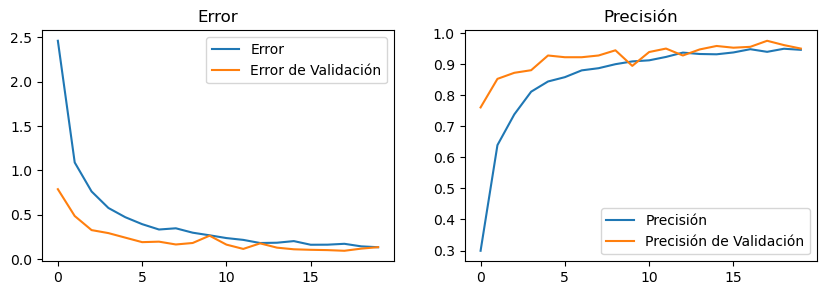


PREDICCIONES

5/5 [==============================] - 0s 19ms/step


IntProgress(value=0, description='Predicciones:', max=144)

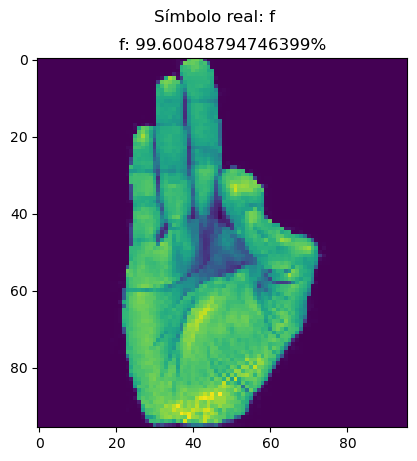

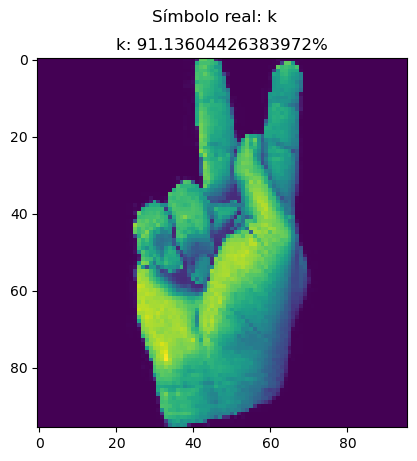

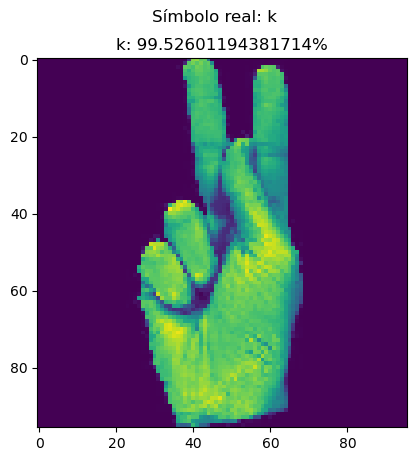

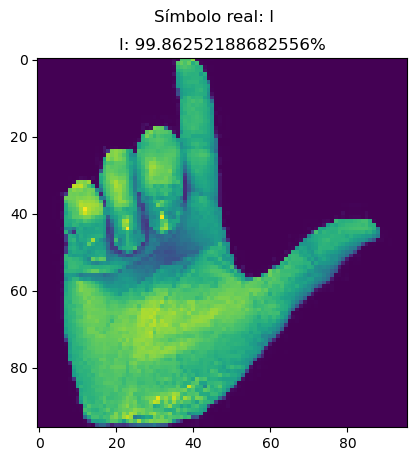

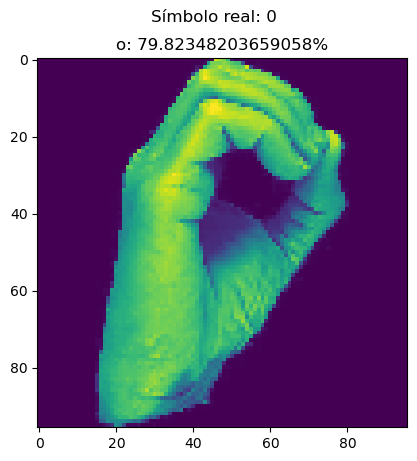

...

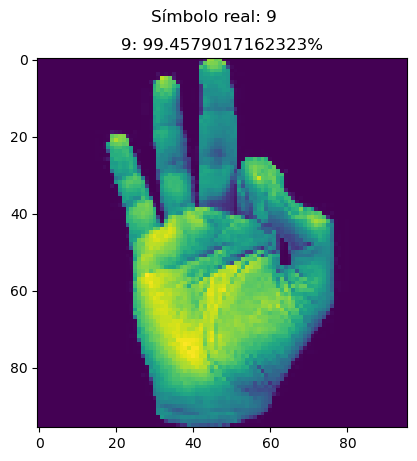

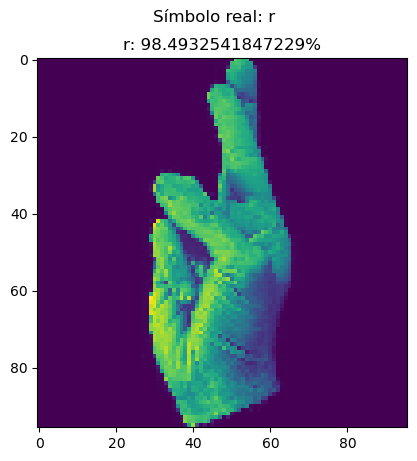

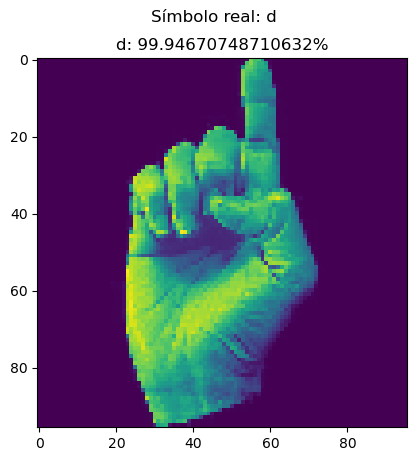

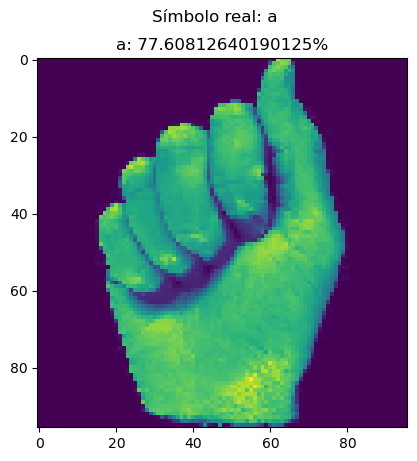

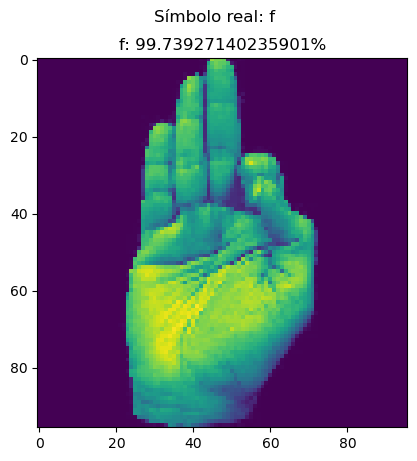


EVALUACIÓN



<Figure size 800x600 with 0 Axes>

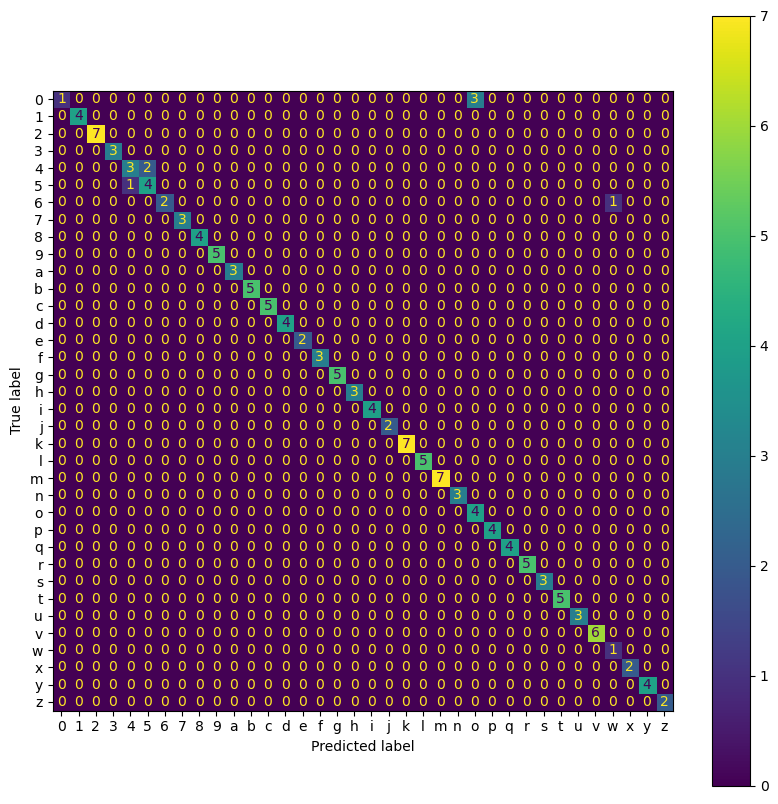

5/5 [==============================] - 0s 19ms/step - loss: 0.1312 - accuracy: 0.9514

El modelo tiene un error de 0.13116571307182312
 y una precisión de 95.13888955116272
% para los datos de prueba

La exactitud del modelo es de 0.9580026455026456
La exhaustividad del modelo es de 0.9532407407407406

Como podemos ver a continuación: 

              precision    recall  f1-score   support

           0       1.00      0.25      0.40         4
           1       1.00      1.00      1.00         4
           2       1.00      1.00      1.00         7
           3       1.00      1.00      1.00         3
           4       0.75      0.60      0.67         5
           5       0.67      0.80      0.73         5
           6       1.00      0.67      0.80         3
           7       1.00      1.00      1.00         3
           8       1.00      1.00      1.00         4
           9       1.00      1.00      1.00         5
           a       1.00      1.00      1.00         3
           b

In [ ]:
lr = [0.005, 0.001, 0.0005, 0.0001, 0.00005, 0.00001]

if not customizar_lr.value:
    models = []
    histories = []

    pBar = IntProgress(value=0, min=0, max=len(lr), description='Modelos:')
    display(pBar)

    for i in range(len(lr)):
        pBar.value += 1
        if not average_pooling.value:
            models.append(createModel_MP(i))
        else:
            models.append(createModel_AP(i))

        opt = ks.optimizers.Adam(lr[i])
        models[i].compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])
        time.sleep(.1)
else:
    if not average_pooling.value:
        modelo = createModel_MP(lr_custom.value)
    else:
        modelo = createModel_AP(lr_custom.value)
    opt = ks.optimizers.Adam(lr[lr_custom.value])
    modelo.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

    print("ENTRENAMIENTO\n")
    historia = trainModel(lr_custom.value, 20, modelo)

    print("\nPREDICCIONES\n")
    x_t = []
    y_t = []
    x, y = test_img.__getitem__(0)
    x_t.append(x)
    y_t.append(y)
    for i in range(1,test_img.__len__()):
        x,y = test_img.next()
        x_t.append(x)
        y_t.append(y)

    x_t = np.concatenate(x_t)
    y_t = np.concatenate(y_t)
    y_tt = np.argmax(y_t, axis=1)


    predictions = models[1].predict(x_t)
    predict_not_ohe = np.argmax(predictions, axis=1)

    pBar = IntProgress(value=0, min=0, max=len(predict_not_ohe), description='Predicciones:')
    display(pBar)

    for idx, chance in enumerate(predict_not_ohe):
        plt.imshow(x_t[idx])
        plt.title(str(labels[predict_not_ohe[idx]]) + ': ' + str(predictions[idx][chance]*100) + '%')
        plt.suptitle('Símbolo real: ' + str(labels[y_tt[idx]]))
        pBar.value += 1
        time.sleep(.1)
        plt.show()

    print("\nEVALUACIÓN\n")
    plt.figure(figsize=(8, 6))
    cm = confusion_matrix(y_tt, predict_not_ohe)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
    fig, ax = plt.subplots(figsize=(10,10))
    disp.plot(ax=ax)
    plt.show()

    evaluacion = models[1].evaluate(x_t, y_t)
    print('\nEl modelo tiene un error de ' + str(evaluacion[0]) + '\n y una precisión de ' + str(evaluacion[1]*100) + '\n% para los datos de prueba\n')
    c_r = classification_report(y_tt, predict_not_ohe, output_dict=True, target_names=labels)
    print('La exactitud del modelo es de ' + str(c_r['macro avg']['precision']))
    print('La exhaustividad del modelo es de ' + str(c_r['macro avg']['recall']))
    print('\nComo podemos ver a continuación: \n')
    print(classification_report(y_tt, predict_not_ohe, target_names=labels))
    print("\n\n\n*IGNORAR LAS CELDAS DE AQUÍ EN ADELANTE*")


### Entrenamiento de Modelos

A continuación mostramos el entrenamiento de cada modelo, viendo su progresión y si estan haciendo:

+ Generalización 👌
+ Underfitting 📉
+ Overfitting 📈

En caso de que todos los modelos presenten overfitting y/o underfitting, hay una serie de medidas que podemos tomar.

#### Overfitting

Para [poder contrarrestar](https://www.researchgate.net/post/How_to_tackle_the_problem_of_constant_val_accuracy_in_CNN_model_training) el overfitting (que podríamos identificar por un val_accuracy constante):

+ Reducir la complejidad del modelo
+ Añadir/aumentar Dropout en las capas finales del modelo
+ Regularización (por ejemplo L2)
+ Data Augmentation (que hemos realizado de una manera muy reducida)
+ Early Stopping (que hemos realizado de una manera muy laxa)

#### Underfitting

Para [poder contrarrestar](https://stackoverflow.com/questions/61568463/keras-validation-accuracy-stays-the-exact-same-but-validation-loss-decreases) el underfitting (que podríamos identificar por un bajo accuracy):

+ Aumentar la complejidad del modelo
+ Eliminar/reducir Dropout
+ Cambiar el batch_size
+ Añadir [class_weights](https://datascience.stackexchange.com/questions/13490/how-to-set-class-weights-for-imbalanced-classes-in-keras) (si el dataset está muy desbalanceado) para equilibrar el número de elementos por clase
+ Tomar un learning rate más bajo para [evitar quedarnos estancados en un mínimo local](https://stackoverflow.com/questions/70872496/high-loss-rate-for-unknow-reason-when-training-cnn)


Para el modelo con learning rate 0.005 y configuración: 
Model: "modelo_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Convolutional_Layer_F1 (Con  (None, 96, 96, 32)       320       
 v2D)                                                            
                                                                 
 Pooling_Layer_F1 (MaxPoolin  (None, 48, 48, 32)       0         
 g2D)                                                            
                                                                 
 Convolutional_Layer_F2 (Con  (None, 48, 48, 64)       18496     
 v2D)                                                            
                                                                 
 Pooling_Layer_F2 (MaxPoolin  (None, 24, 24, 64)       0         
 g2D)                                                            
                                                                 
 

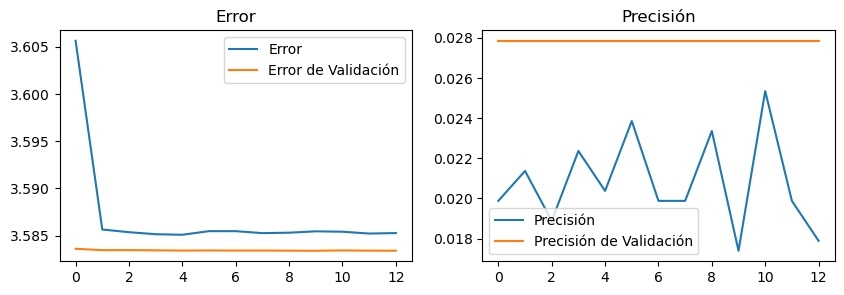

In [ ]:
histories.append(trainModel(0, 20, models[0]))

Para el modelo con learning rate 0.001 y configuración: 
Model: "modelo_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Convolutional_Layer_F1 (Con  (None, 96, 96, 32)       320       
 v2D)                                                            
                                                                 
 Pooling_Layer_F1 (MaxPoolin  (None, 48, 48, 32)       0         
 g2D)                                                            
                                                                 
 Convolutional_Layer_F2 (Con  (None, 48, 48, 64)       18496     
 v2D)                                                            
                                                                 
 Pooling_Layer_F2 (MaxPoolin  (None, 24, 24, 64)       0         
 g2D)                                                            
                                                                 
 

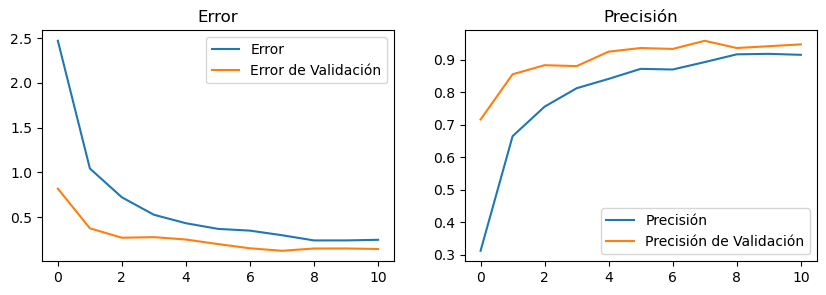

In [ ]:
histories.append(trainModel(1, 20, models[1]))

Para el modelo con learning rate 0.0005 y configuración: 
Model: "modelo_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Convolutional_Layer_F1 (Con  (None, 96, 96, 32)       320       
 v2D)                                                            
                                                                 
 Pooling_Layer_F1 (MaxPoolin  (None, 48, 48, 32)       0         
 g2D)                                                            
                                                                 
 Convolutional_Layer_F2 (Con  (None, 48, 48, 64)       18496     
 v2D)                                                            
                                                                 
 Pooling_Layer_F2 (MaxPoolin  (None, 24, 24, 64)       0         
 g2D)                                                            
                                                                 


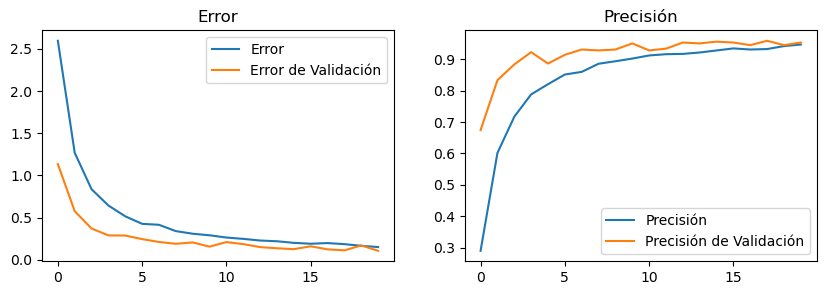

In [ ]:
histories.append(trainModel(2, 20, models[2]))

Para el modelo con learning rate 0.0001 y configuración: 
Model: "modelo_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Convolutional_Layer_F1 (Con  (None, 96, 96, 32)       320       
 v2D)                                                            
                                                                 
 Pooling_Layer_F1 (MaxPoolin  (None, 48, 48, 32)       0         
 g2D)                                                            
                                                                 
 Convolutional_Layer_F2 (Con  (None, 48, 48, 64)       18496     
 v2D)                                                            
                                                                 
 Pooling_Layer_F2 (MaxPoolin  (None, 24, 24, 64)       0         
 g2D)                                                            
                                                                 


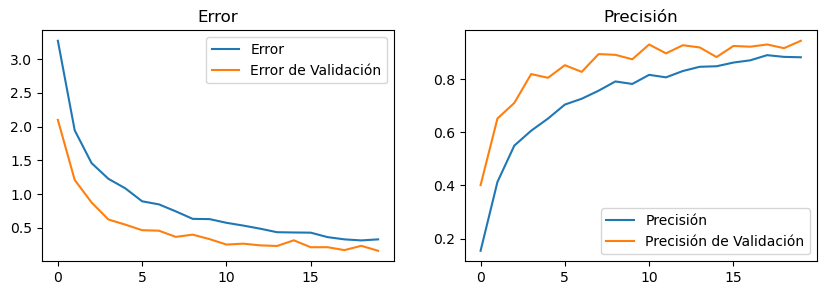

In [ ]:
histories.append(trainModel(3, 20, models[3]))

Para el modelo con learning rate 5e-05 y configuración: 
Model: "modelo_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Convolutional_Layer_F1 (Con  (None, 96, 96, 32)       320       
 v2D)                                                            
                                                                 
 Pooling_Layer_F1 (MaxPoolin  (None, 48, 48, 32)       0         
 g2D)                                                            
                                                                 
 Convolutional_Layer_F2 (Con  (None, 48, 48, 64)       18496     
 v2D)                                                            
                                                                 
 Pooling_Layer_F2 (MaxPoolin  (None, 24, 24, 64)       0         
 g2D)                                                            
                                                                 
 

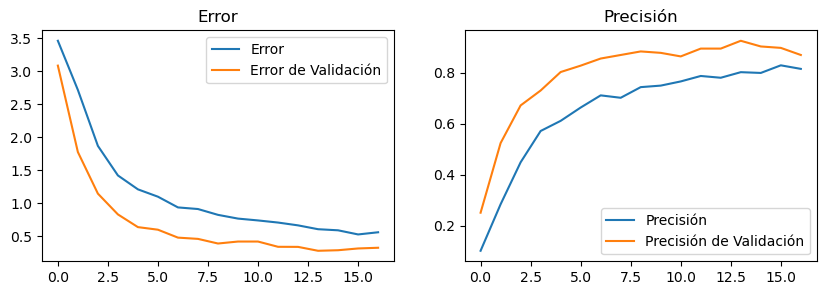

In [ ]:
histories.append(trainModel(4, 20, models[4]))

Para el modelo con learning rate 1e-05 y configuración: 
Model: "modelo_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Convolutional_Layer_F1 (Con  (None, 96, 96, 32)       320       
 v2D)                                                            
                                                                 
 Pooling_Layer_F1 (MaxPoolin  (None, 48, 48, 32)       0         
 g2D)                                                            
                                                                 
 Convolutional_Layer_F2 (Con  (None, 48, 48, 64)       18496     
 v2D)                                                            
                                                                 
 Pooling_Layer_F2 (MaxPoolin  (None, 24, 24, 64)       0         
 g2D)                                                            
                                                                 
 

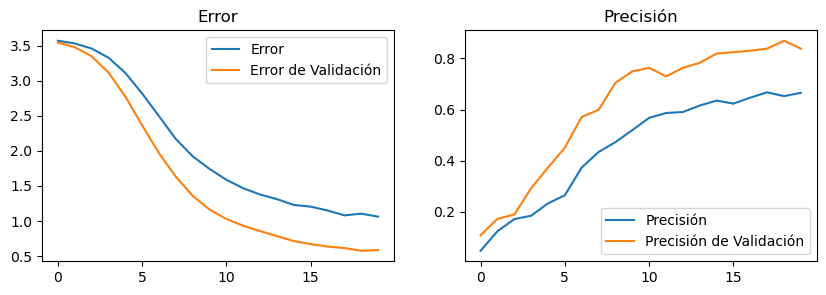

In [ ]:
histories.append(trainModel(5, 20, models[5]))

Podemos ver en los entrenamientos, que cuanto más bajo se vuelve el learning rate, peor precisión conseguimos alcanzar debido a la lentitud del entrenamiento y que, en ocasiones, los learning rates demasiado altos provocan que el error de validación del modelo suba más rápido.

Teniendo esto en cuenta y viendo las métricas del entrenamiento, podemo ver que el "modelo_2" o `modelos[1]` es el que ha conseguido el mejor entrenamiento; con menores errores (normal y de validación) y mayores precisiones (también en ambas).

### Análisis del Modelo

Para analizar el modelo, primero lo hacemos predecir y mostramos las predicciones que realiza el modelo así como el porcentaje de seguridad que tiene la red de haber acertado.

5/5 [==============================] - 0s 23ms/step


IntProgress(value=0, description='Predicciones:', max=160)

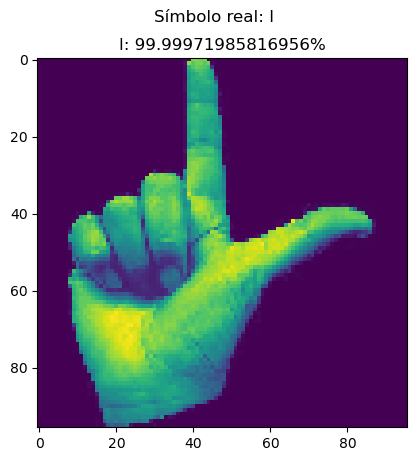

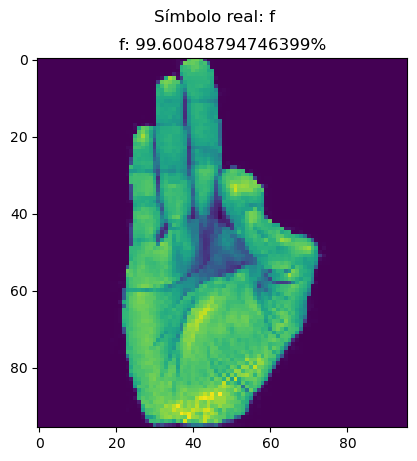

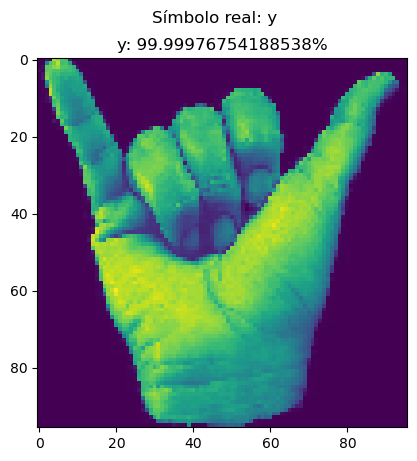

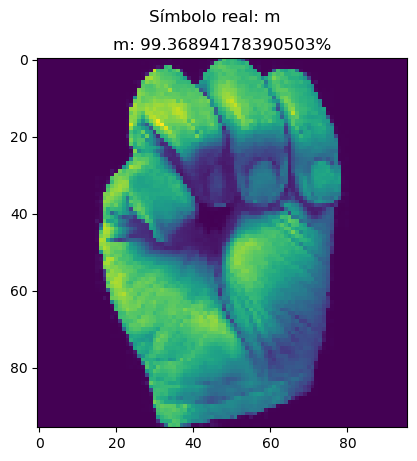

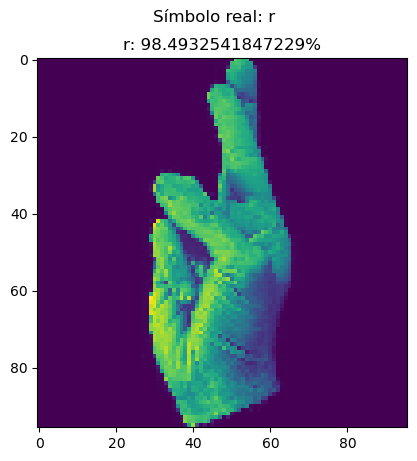

...

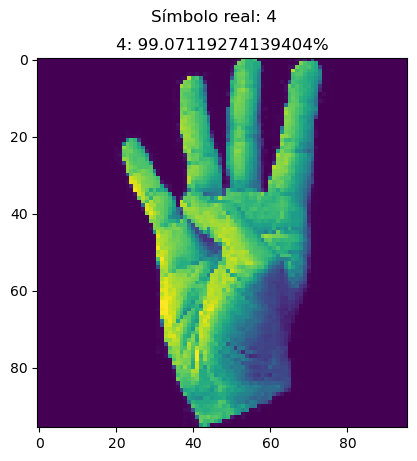

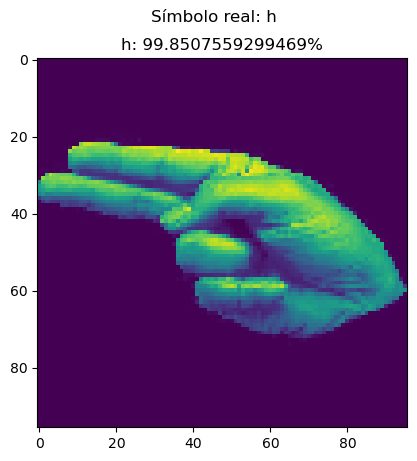

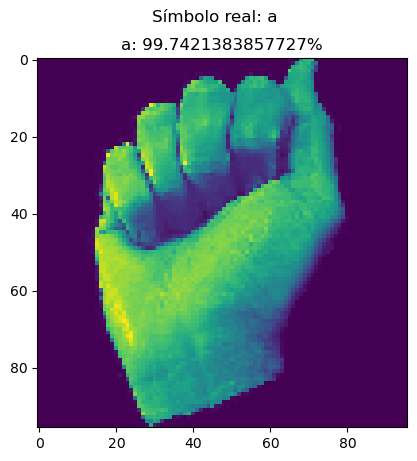

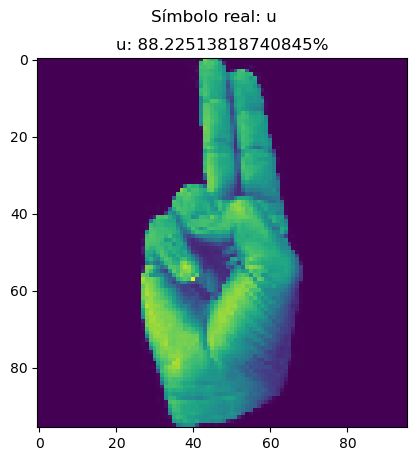

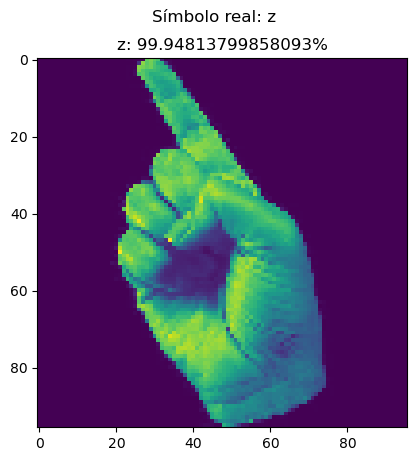

In [ ]:
x_t = []
y_t = []
x, y = test_img.__getitem__(0)
x_t.append(x)
y_t.append(y)

for i in range(1,test_img.__len__()):
    x,y = test_img.next()
    x_t.append(x)
    y_t.append(y)

x_t = np.concatenate(x_t)
y_t = np.concatenate(y_t)
y_tt = np.argmax(y_t, axis=1)

predictions = models[1].predict(x_t)
predict_not_ohe = np.argmax(predictions, axis=1)

pBar = IntProgress(value=0, min=0, max=len(predict_not_ohe), description='Predicciones:')
display(pBar)

for idx, chance in enumerate(predict_not_ohe):
    plt.imshow(x_t[idx])
    plt.title(str(labels[predict_not_ohe[idx]]) + ': ' + str(predictions[idx][chance]*100) + '%')
    plt.suptitle('Símbolo real: ' + str(labels[y_tt[idx]]))
    pBar.value += 1
    time.sleep(.1)
    plt.show()

Después de haber predecido, podemos ver (a ojo) que parece que el modelo clasifica bien y con un alto grado de seguridad; sin embargo, para poder interpretar estas predicciones mejor, necesitamos organizarlas.

#### Predicciones Organizadas

Nuestra forma de organizar estas predicciones es con una matriz de confusión; que, gracias a que el número de clases no es excesivamente grande, sigue siendo válida como forma de representarlas.

<Figure size 800x600 with 0 Axes>

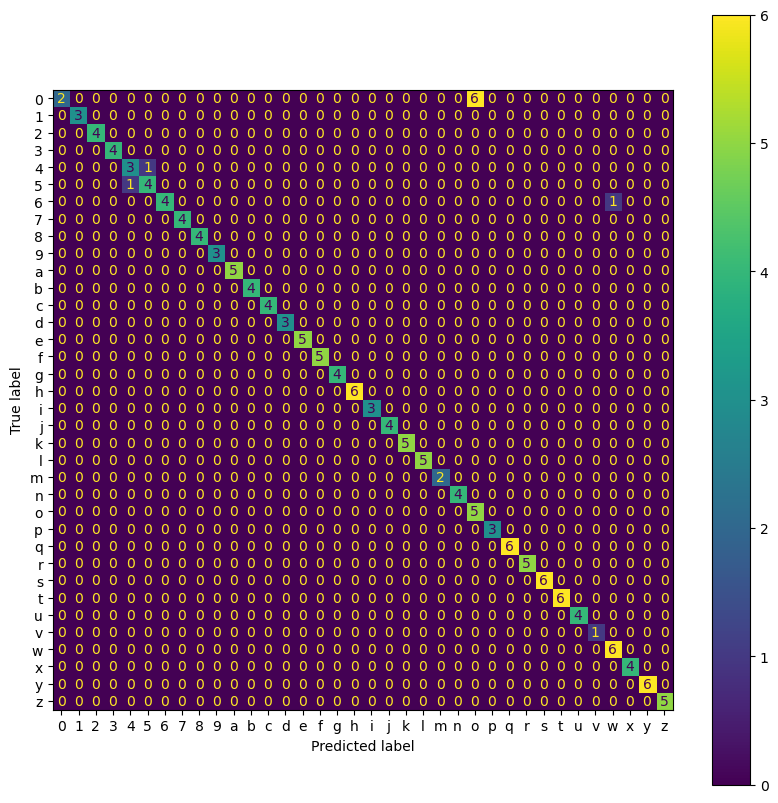

In [ ]:
plt.figure(figsize=(8, 6))
cm = confusion_matrix(y_tt, predict_not_ohe)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
fig, ax = plt.subplots(figsize=(10,10))
disp.plot(ax=ax)
plt.show()

Podemos ver que el modelo clasifica de maner muy acertada, exceptuando 4 casos, de los cuales 1 se repite particularmente. Parece ser que el modelo predice la 'o' como '0'; cosa que, debido al parecido de ambos gestos, tiene sentido que ocurra.

#### Evaluación del modelo

A partir de los datos obtenidos del modelo, evaluamos el modelo y analizamos los datos de esa evaluación y del informe de clasificación; el cual, en esencia es una interpretación de la matriz de confusión.

In [ ]:
evaluacion = models[1].evaluate(x_t, y_t)
print('\nEl modelo tiene un error de ' + str(evaluacion[0]) + '\n y una precisión de ' + str(evaluacion[1]*100) + '\n% para los datos de prueba\n')
c_r = classification_report(y_tt, predict_not_ohe, output_dict=True, target_names=labels)
print('La exactitud del modelo es de ' + str(c_r['macro avg']['precision']))
print('La recuperación del modelo es de ' + str(c_r['macro avg']['recall']))
print('\nComo podemos ver a continuación: \n')
print(classification_report(y_tt, predict_not_ohe, target_names=labels))

5/5 [==============================] - 0s 22ms/step - loss: 0.1513 - accuracy: 0.9438

El modelo tiene un error de 0.15127936005592346
y una precisión de 0.9437500238418579
para los datos de prueba

La exactitud del modelo es de 0.9683802308802308
La exhaustividad del modelo es de 0.9611111111111111

Como podemos ver a continuación: 

              precision    recall  f1-score   support

           0       1.00      0.25      0.40         8
           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         4
           3       1.00      1.00      1.00         4
           4       0.75      0.75      0.75         4
           5       0.80      0.80      0.80         5
           6       1.00      0.80      0.89         5
           7       1.00      1.00      1.00         4
           8       1.00      1.00      1.00         4
           9       1.00      1.00      1.00         3
           a       1.00      1.00      1.00         5
           b  

Los datos en los que nos vamos a fijar de este análisis son:

+ [Error del modelo](https://www.simplilearn.com/tutorials/machine-learning-tutorial/bias-and-variance#:~:text=these%20errors%20are.-,Errors%20in%20Machine%20Learning,well%20as%20new%2C%20unseen%20data.) &rarr; La diferencia entre lo deseado y lo obtenido. Es decir: ¿Qué tanto falla mi modelo al predecir datos tanto nuevos como ya vistos?
+ [Precisión](https://developers.google.com/machine-learning/crash-course/classification/accuracy?hl=en) del modelo &rarr; Qué tan cerca está una predicción del valor verdadero. Es decir: "¿Qué proporción de muestras se han clasificado correctamente?"
+ [Exactitud](https://developers.google.com/machine-learning/crash-course/classification/precision-and-recall?hl=en) del modelo &rarr; Qué tan cerca se encuentran las predicciones de la misma entrada entre sí. Es decir: "¿Qué proporción de identificaciones positivas fue correcta?"
+ [Recuperación](https://developers.google.com/machine-learning/crash-course/classification/precision-and-recall?hl=en) del modelo &rarr; Qué porcentaje de muestras de datos que un modelo identifica correctamente como pertenecientes a una clase del total de muestras para esa clase. Es decir: "¿Qué proporción de positivos reales se identificó en forma correcta?"

Debido al parecido entre la precisión y la exactitud, [tomamos este gráfico](https://manoa.hawaii.edu/exploringourfluidearth/physical/world-ocean/map-distortion/practices-science-precision-vs-accuracy#:~:text=Accuracy%20refers%20to%20how%20close,Precision%20is%20independent%20of%20accuracy.) para entenderla mejor:

![target](https://manoa.hawaii.edu/exploringourfluidearth/sites/default/files/styles/full-page-width/public/M1U1-SF%201-5_Accuracy%20and%20Precision.png?itok=5AwAATOc)

+ En A &rarr; Ni Precisión, ni Exactitud
+ En B &rarr; Si Precisión, no Exactitud
+ En C &rarr; No Precisión, si Exactitud
+ En D &rarr; Precisión y Exactitud

Podríamos decir que nuestro modelo, que pertenece a la diana D de la imágen anterior, es excelente a la hora de clasificar patrones en sus correspondientes clases, presentando un poco de dificultades, probablemente, para algún patrón desconocido y para ejemplos muy similares entre sí (como la 'o' y el '0').